
<h1>Primera Entrega - Proyecto de Procesamiento de datos a gran escala</h1>

<h2>Fecha: 10/04/2024</h2>


<h4>Programas</h4>
<h5>Ciencia de datos e Ingeniería de Sistemas</h5>
<h4>Integrantes</h4>
<p>Santiago Botero Pacheco</p>
<p>Santiago Rueda Pineda</p>
<p>Santiago Avilés Tibocha</p>
<p>Brayan Steven Carrillo Mora</p>
<p style = 'text-align:center;'>
<img src="https://upload.wikimedia.org/wikipedia/commons/thumb/6/6c/Javeriana.svg/1200px-Javeriana.svg.png" height="200" width="300">
</p>


## Crear Entorno de Ejecución

In [0]:
#Importar bibliotecas necesarias para el analisis
import pandas as pd
import pyspark
from pyspark import SparkContext
from pyspark.sql import *
from pyspark.sql.functions import *
from pyspark.sql.types import *
import seaborn as sns
import matplotlib.pyplot as plt

In [0]:
#Crear el entorno (contexto) de Pyspark SQL
spark = SparkContext.getOrCreate()
spark = SparkSession.builder.appName("Proyecto1").getOrCreate()

sc = SparkContext.getOrCreate()
sql_c = SQLContext(sc)
sc

/databricks/spark/python/pyspark/sql/context.py:118: FutureWarning: Deprecated in 3.0.0. Use SparkSession.builder.getOrCreate() instead.
  warnings.warn(


<SparkContext master=local[8] appName=Databricks Shell>

## Colección y descripción de datos:

In [0]:
#Crear dataset usando el path del repositorio de github

path = "https://raw.githubusercontent.com/Raaiinn/project-data-process/main/data/NYCgov_Poverty_Measure_Data__2018__20240410.csv"
pd_pobreza_df = pd.read_csv(path)
spark_pobreza_df = spark.createDataFrame(pd_pobreza_df) #Convertir a PySpark 

###Tabla de datos

In [0]:
display(spark_pobreza_df)

SERIALNO,SPORDER,PWGTP,WGTP,AGEP,CIT,REL,SCH,SCHG,SCHL,SEX,ESR,LANX,ENG,MSP,MAR,WKW,WKHP,DIS,JWTR,NP,TEN,HHT,AgeCateg,Boro,CitizenStatus,EducAttain,EST_Childcare,EST_Commuting,EST_EITC,EST_FICAtax,EST_HEAP,EST_Housing,EST_IncomeTax,EST_MOOP,EST_Nutrition,EST_PovGap,EST_PovGapIndex,Ethnicity,FamType_PU,FTPTWork,INTP_adj,MRGP_adj,NYCgov_Income,NYCgov_Pov_Stat,NYCgov_REL,NYCgov_Threshold,Off_Pov_Stat,Off_Threshold,OI_adj,PA_adj,Povunit_ID,Povunit_Rel,PreTaxIncome_PU,RETP_adj,RNTP_adj,SEMP_adj,SSIP_adj,SSP_adj,TotalWorkHrs_PU,WAGP_adj
1,1,95,95,31,1,0,1,0,22.0,2,1.0,2.0,null,6.0,5,1.0,60,2,12.0,1,2,6,2,2,1,4.0,0.0,1722.0,0.0,9765.2422,0.0,1478.3278,33580.543,2642.8,0.0,0.0,0.0,4,8,1,0.0,0.0,81417.961,2,0,16241.6,2,13064,0.0,0.0,1,1,127650.22,0.0,0.0,0.0,0.0,0.0,2,127650.22
16,1,181,181,63,1,0,1,0,22.0,2,1.0,2.0,null,1.0,1,1.0,60,2,1.0,2,1,1,2,3,1,4.0,0.0,3840.8416,0.0,13950.346,0.0,0.0,95503.234,4766.7998,0.0,0.0,0.0,1,2,1,101309.7,2532.7424,228417.95,2,0,22900.654,2,16815,0.0,0.0,1,1,346479.19,0.0,0.0,0.0,0.0,0.0,2,182357.45
16,2,210,181,65,1,1,1,0,19.0,1,6.0,2.0,null,1.0,1,null,0,2,null,2,1,1,3,3,1,3.0,0.0,3840.8416,0.0,13950.346,0.0,0.0,95503.234,4766.7998,0.0,0.0,0.0,1,2,3,50654.852,2532.7424,228417.95,2,1,22900.654,2,16815,0.0,0.0,1,2,346479.19,0.0,0.0,0.0,0.0,12157.164,2,0.0
47,1,62,62,68,4,0,1,0,1.0,1,1.0,1.0,2.0,1.0,1,1.0,40,2,10.0,2,2,1,3,2,2,1.0,0.0,0.0,0.0,9765.2422,0.0,2612.8022,27574.365,3218.8,0.0,0.0,0.0,1,2,1,0.0,0.0,117058.23,2,0,22900.654,2,15178,0.0,0.0,1,1,155003.84,0.0,0.0,0.0,0.0,27353.619,1,91178.727
47,2,71,62,63,4,1,1,0,1.0,2,1.0,1.0,1.0,1.0,1,1.0,40,2,10.0,2,2,1,2,2,2,1.0,0.0,0.0,0.0,9765.2422,0.0,2612.8022,27574.365,3218.8,0.0,0.0,0.0,1,2,1,0.0,0.0,117058.23,2,1,22900.654,2,15178,0.0,0.0,1,2,155003.84,0.0,0.0,0.0,0.0,0.0,1,36471.492
55,1,430,430,29,5,0,1,0,21.0,2,6.0,1.0,3.0,1.0,1,1.0,40,2,null,3,3,1,2,4,3,4.0,0.0,4954.1665,0.0,2915.3896,0.0,0.0,1115.2131,0.0,0.0,3214.7793,0.14037937,4,2,1,0.0,0.0,19685.875,1,0,22900.654,2,16815,0.0,0.0,1,1,28670.645,0.0,2026.194,0.0,0.0,0.0,1,17526.578
55,2,466,430,25,5,1,1,0,21.0,1,1.0,1.0,1.0,1.0,1,1.0,40,2,1.0,3,3,1,2,4,3,4.0,0.0,4954.1665,0.0,2915.3896,0.0,0.0,1115.2131,0.0,0.0,3214.7793,0.14037937,4,2,1,0.0,0.0,19685.875,1,1,22900.654,2,16815,0.0,0.0,1,2,28670.645,0.0,2026.194,11144.067,0.0,0.0,1,0.0
55,3,453,430,32,1,15,1,0,16.0,1,1.0,1.0,1.0,6.0,5,1.0,40,2,1.0,3,3,1,2,4,1,2.0,0.0,6703.5,0.0,3875.0959,0.0,0.0,8213.8594,4176.96,0.0,0.0,0.0,4,7,1,0.0,0.0,27685.434,2,12,16241.6,2,13064,0.0,0.0,2,1,50654.852,0.0,2026.194,0.0,0.0,0.0,3,50654.852
194,1,201,201,76,4,0,1,0,21.0,1,6.0,2.0,null,3.0,2,null,0,2,null,1,3,4,3,2,2,4.0,0.0,0.0,0.0,0.0,0.0,0.0,1558.6013,1378.6801,0.0,0.0,0.0,2,8,3,405.2388,0.0,40727.199,2,0,16241.6,2,12043,0.0,0.0,1,1,43664.48,23402.541,891.52533,0.0,0.0,19856.701,5,0.0
218,1,55,56,46,5,0,1,0,17.0,2,1.0,1.0,4.0,1.0,1,1.0,35,2,4.0,2,3,1,2,2,3,2.0,0.0,1795.8,0.0,6122.6519,0.0,0.0,11775.876,9036.96,0.0,0.0,0.0,3,2,1,0.0,0.0,51303.375,2,0,22900.654,2,16815,0.0,0.0,1,1,80034.664,0.0,911.78729,0.0,0.0,0.0,2,70916.789


### Tipos de datos encontrados en el dataframe extraído

In [0]:
spark_pobreza_df.printSchema()

root
 |-- SERIALNO: long (nullable = true)
 |-- SPORDER: long (nullable = true)
 |-- PWGTP: long (nullable = true)
 |-- WGTP: long (nullable = true)
 |-- AGEP: long (nullable = true)
 |-- CIT: long (nullable = true)
 |-- REL: long (nullable = true)
 |-- SCH: long (nullable = true)
 |-- SCHG: long (nullable = true)
 |-- SCHL: double (nullable = true)
 |-- SEX: long (nullable = true)
 |-- ESR: double (nullable = true)
 |-- LANX: double (nullable = true)
 |-- ENG: double (nullable = true)
 |-- MSP: double (nullable = true)
 |-- MAR: long (nullable = true)
 |-- WKW: double (nullable = true)
 |-- WKHP: long (nullable = true)
 |-- DIS: long (nullable = true)
 |-- JWTR: double (nullable = true)
 |-- NP: long (nullable = true)
 |-- TEN: long (nullable = true)
 |-- HHT: long (nullable = true)
 |-- AgeCateg: long (nullable = true)
 |-- Boro: long (nullable = true)
 |-- CitizenStatus: long (nullable = true)
 |-- EducAttain: double (nullable = true)
 |-- EST_Childcare: double (nullable = true)
 |-

### Diccionario de Datos
* **serialno**: Número de serie o identificador del registro individual.
* **sporder**: Orden secuencial de la persona en el hogar.
* **pwgtp**: Peso de la persona.
* **wgtp**: Peso del hogar.
* **agep**: Edad de la persona.
* **cit**: Estado de ciudadanía.
* **rel**: Relación con el cabeza de familia.
* **sch**: Asistencia a la escuela.
* **schg**: Grado al que asiste.
* **Schl**: Nivel de estudios.
* **sex**: Sexo.
* **esr**: Situación laboral.
* **lanx**: Idioma hablado en casa.
* **msp**: Estado civil.
* **mar**: Historial matrimonial.
* **wkw**: Semanas trabajadas.
* **wkhp**: Horas trabajadas por semana.
* **dis**: Situación de discapacidad.
* **jwtr**: Medio de transporte al trabajo.
* **np**: Número de personas en el hogar.
* **ten**: Tenencia. (propietario/alquilador).
* **hht**: Tipo de hogar.
* **agecateg**: Categoría de edad.
* **boro**: Municipio.
* **citizenstatus**: Estado de nacionalidad.
* **educattain**: Nivel de estudios.
* **est_childcare**: Gastos estimados de guardería.
* **est_commuting**: Gastos estimados de desplazamiento al trabajo.
* **est_eitc**: Estimación del EITC (crédito fiscal por ingresos del trabajo).
* **est_ficatax**: Estimación del impuesto FICA.
* **est_heap**: Estimación HEAP (Home Energy Assistance Program).
* **est_housing**: Gastos estimados de vivienda.
* **est_incometax**: Estimación del impuesto sobre la renta.
* **est_moop**: Estimación del MOOP (gasto máximo de bolsillo).
* **est_nutrition**: Gastos estimados de nutrición.
* **est_povgap**:Brecha de pobreza estimada.
* **est_povgapindex**:Índice estimado de la brecha de pobreza.
* **ethnicity**: Etnia.
* **famtype_pu**: Tipo de familia.
* **ftptwork**: Situación laboral a tiempo completo o parcial.
* **intp_adj**: Ajuste de los ingresos por intereses.
* **mrgp_adj**: Ajuste del pago de la hipoteca.
* **nycgov_income**: Ingresos del gobierno de NYC.
* **nycgov_pov_stat**: Estado de pobreza del gobierno de NYC.
* **nycgov_rel**: Relación con el gobierno de NYC.
* **nycgov_threshold**: Umbral del gobierno de NYC.
* **Off_pov_stat**: Estado oficial de pobreza.
* **off_threshold**: Umbral oficial de pobreza.
* **oi_adj**: Ajuste por otros ingresos.
* **pa_adj**: Ajuste de ingresos por asistencia pública.
* **Povunit_id**: ID de la unidad de pobreza.
* **povunit_rel**: Relación con la unidad de pobreza.
* **pretaxincome_pu**: Renta antes de impuestos.
* **retp_adj**: Ajuste de ingresos por jubilación.
* **rntp_adj**: Ajuste de la renta de alquiler.
* **semp_adj**: Ajuste de los ingresos por trabajo autónomo.
* **ssip_adj**: upplemental Security Income (SSI) adjustment.
* **ssp_adj**: Ajuste de los ingresos de la Seguridad Social.
* **totalworkhrs_pu**: *Total de horas de trabajo por unidad de pobreza.
* **wagp_adj**: Ajuste de los ingresos salariales.
* **eng**: Dominio del inglés.

### Seleccion de columnas de interes

Seleccionamos las siguientes columnas pues pueden ser las que más sentido e impacto traigan a nuestro análisis

- **agep**	Edad de la persona, que puede proporcionar información sobre las tasas de pobreza en diferentes grupos de edad.
- **schl**	Nivel de educación, ya que está estrechamente relacionado con las oportunidades de empleo y los niveles de ingresos.
- **sex**	Género, para examinar las posibles diferencias en las tasas de pobreza entre hombres y mujeres.
- **wkw y wkhp**	Semanas trabajadas y horas trabajadas por semana, que pueden indicar el estado de empleo y los niveles de ingresos.
- **msp**	Estado civil, ya que puede influir en la estructura y los recursos del hogar.
- **hht**	Tipo de hogar, para entender cómo diferentes composiciones de los hogares se ven afectadas por la pobreza.
- **boro**	Util para identificar posibles desbalances geográficos en la pobreza dentro de la ciudad de Nueva York.
- **est_childcare, est_commuting, est_housing**	Gastos estimados que pueden afectar significativamente la situación financiera de un hogar.
- **est_povgap y est_povgapindex**	Medidas de la profundidad de la pobreza, que proporcionan información sobre la gravedad del problema.
- **nycgov_pov_stat y off_pov_stat**	Estado de pobreza oficial según las medidas del gobierno de la ciudad de Nueva York y el gobierno federal, lo que permite realizar comparaciones.
- **pretaxincome_pu**	Ingresos pre-impuestos por unidad de pobreza, un indicador clave de los recursos financieros.
- **totalworkhrs_pu**	Total de horas trabajadas por unidad de pobreza, capturando la intensidad del empleo.

In [0]:
#Debido a la gran cantidad de columnas presentes en el dataset, vamos a eliminar y limpiar algunas para elegir las de mayor interés para nosotros
columns_to_keep = ['agep', 'schl', 'sex', 'wkw', 'wkhp', 'msp', 'hht', 'boro', 
                   'est_childcare', 'est_commuting', 'est_housing', 'est_povgap', 
                   'est_povgapindex', 'nycgov_pov_stat', 'off_pov_stat', 'pretaxincome_pu', 
                   'totalworkhrs_pu']
clean_spark_poverty = spark_pobreza_df.select(*columns_to_keep)

#Se cambiara el nombre de las columnas para mayor interpretación
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('agep', 'edad')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('schl', 'educacion')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('sex', 'sexo')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('wkw', 'semanas_trabajadas')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('wkhp', 'horas_trabajadas')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('msp', 'estado_civil')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('hht', 'tipo_hogar')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('boro', 'condado')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_childcare','est_cuidado_infantil')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_commuting', 'est_transporte')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_housing', 'est_vivienda')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_povgap', 'brecha_pobreza')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('est_povgapindex', 'indice_brecha_pobreza')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('nycgov_pov_stat', 'estado_pobreza_nyc')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('off_pov_stat', 'estado_pobreza_oficial')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('pretaxincome_pu', 'ingresos_pre_impuestos')
clean_spark_poverty = clean_spark_poverty.withColumnRenamed('totalworkhrs_pu', 'tot_hrs_trabajo_pu')

display(clean_spark_poverty)

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
31,22.0,2,1.0,60,6.0,6,2,0.0,1722.0,1478.3278,0.0,0.0,2,2,127650.22,2
63,22.0,2,1.0,60,1.0,1,3,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
65,19.0,1,null,0,1.0,1,3,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
68,1.0,1,1.0,40,1.0,1,2,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
63,1.0,2,1.0,40,1.0,1,2,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
29,21.0,2,1.0,40,1.0,1,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
25,21.0,1,1.0,40,1.0,1,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
32,16.0,1,1.0,40,6.0,1,4,0.0,6703.5,0.0,0.0,0.0,2,2,50654.852,3
76,21.0,1,null,0,3.0,4,2,0.0,0.0,0.0,0.0,0.0,2,2,43664.48,5
46,17.0,2,1.0,35,1.0,1,2,0.0,1795.8,0.0,0.0,0.0,2,2,80034.664,2


## EDA - Analisis Exploratorio

### Estadisticos de todas las columnas
- Al ser todas las columnas valores numericos se espera un reporte sin errores o valores nulos

In [0]:
display(clean_spark_poverty.describe())

summary,edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
count,68273,66166,68273,36879,68273,57252,68273,68273,68273,68273,68273,68273,68273,68273,68273,68273,68273
mean,39.64726905218754,16.14156817700934,1.5316010721661564,1.731690121749505,20.731738754705376,3.479616432613708,2.3407349904061636,2.786767829156475,1164.697401094199,2290.999144816122,2840.644254834593,1789.325946137725,0.06397607685464375,1.8225799364316786,1.8583041612350417,112312.04741030838,2.478007411421792
stddev,22.568387312563864,6.03218267734675,0.4990040274727757,1.484705855251405,21.180743230758136,2.272040232015264,1.8116524586303995,1.1955370075737919,5082.004878976743,2673.167872306873,5582.069830025632,5324.368887048603,0.1846559232647502,0.3820265989034003,0.3487404614007823,135766.82132941092,1.4405105758063659
min,0,1.0,1,1.0,0,1.0,1,1,0.0,0.0,0.0,0.0,0.0,1,1,-6787.75,1
max,95,24.0,2,6.0,99,6.0,7,5,50803.949,37763.5,36710.223,54978.477,1.0,2,2,1782037.6,5


### Graficas de Interes

#### Distribución de edades

In [0]:
clean_spark_poverty.createOrReplaceTempView("data_eda") #Crear vista tempral

In [0]:
%sql
SELECT edad FROM data_eda

edad
31
63
65
68
63
29
25
32
76
46


Databricks visualization. Run in Databricks to view.

#### Distribución del nivel de educación

In [0]:
%sql
SELECT educacion FROM data_eda

educacion
22.0
22.0
19.0
1.0
1.0
21.0
21.0
16.0
21.0
17.0


Databricks visualization. Run in Databricks to view.

#### Distribución por sexo

In [0]:
%sql
SELECT sexo, count(sexo) as Fecuencia FROM data_eda GROUP BY sexo

sexo,Fecuencia
1,31979
2,36294


Databricks visualization. Run in Databricks to view.

#### Ingresos pre-impuestos vs total de horas trabajadas


In [0]:
%sql

SELECT ingresos_pre_impuestos, tot_hrs_trabajo_pu FROM data_eda

ingresos_pre_impuestos,tot_hrs_trabajo_pu
127650.22,2
346479.19,2
346479.19,2
155003.84,1
155003.84,1
28670.645,1
28670.645,1
50654.852,3
43664.48,5
80034.664,2


Databricks visualization. Run in Databricks to view.

#### Distribucion brecha de pobreza

In [0]:
%sql
SELECT brecha_pobreza FROM data_eda

brecha_pobreza
0.0
0.0
0.0
0.0
0.0
3214.7793
3214.7793
0.0
0.0
0.0


Databricks visualization. Run in Databricks to view.

### Resumen usando Histogramas

In [0]:
%sql
select * from data_eda

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
31,22.0,2,1.0,60,6.0,6,2,0.0,1722.0,1478.3278,0.0,0.0,2,2,127650.22,2
63,22.0,2,1.0,60,1.0,1,3,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
65,19.0,1,null,0,1.0,1,3,0.0,3840.8416,0.0,0.0,0.0,2,2,346479.19,2
68,1.0,1,1.0,40,1.0,1,2,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
63,1.0,2,1.0,40,1.0,1,2,0.0,0.0,2612.8022,0.0,0.0,2,2,155003.84,1
29,21.0,2,1.0,40,1.0,1,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
25,21.0,1,1.0,40,1.0,1,4,0.0,4954.1665,0.0,3214.7793,0.14037937,1,2,28670.645,1
32,16.0,1,1.0,40,6.0,1,4,0.0,6703.5,0.0,0.0,0.0,2,2,50654.852,3
76,21.0,1,null,0,3.0,4,2,0.0,0.0,0.0,0.0,0.0,2,2,43664.48,5
46,17.0,2,1.0,35,1.0,1,2,0.0,1795.8,0.0,0.0,0.0,2,2,80034.664,2


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

## Reporte de Calidad de Datos

In [0]:
display(clean_spark_poverty.select([count(when(isnan(c) | col(c).isNull(), c)).alias(c) for c in clean_spark_poverty.columns]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,2107,0,31394,0,11021,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Proporcion de nulos segun el total de datos
null_counts = []

for column in clean_spark_poverty.columns:
    # Contar los valores nulos en la columna actual
    null_count = clean_spark_poverty.filter(clean_spark_poverty[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / clean_spark_poverty.count()}")

Cantidad de valores nulos en la columna 'edad': 0.0
Cantidad de valores nulos en la columna 'educacion': 0.030861394694828116
Cantidad de valores nulos en la columna 'sexo': 0.0
Cantidad de valores nulos en la columna 'semanas_trabajadas': 0.4598303868293469
Cantidad de valores nulos en la columna 'horas_trabajadas': 0.0
Cantidad de valores nulos en la columna 'estado_civil': 0.1614254536932609
Cantidad de valores nulos en la columna 'tipo_hogar': 0.0
Cantidad de valores nulos en la columna 'condado': 0.0
Cantidad de valores nulos en la columna 'est_cuidado_infantil': 0.0
Cantidad de valores nulos en la columna 'est_transporte': 0.0
Cantidad de valores nulos en la columna 'est_vivienda': 0.0
Cantidad de valores nulos en la columna 'brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'indice_brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_nyc': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_oficial': 0.0
Cantidad de valores nulos en la 

Como podemos observar, los valores nulos se concentran solamente en tres de las columnas que hemos seleccionado: 'educacion' , 'semanas_trabajadas' y 'estado_civil'. Esto siginifica quye los datos tienen una calidad bastante considerable pues estos valores faltantes no afectan la globalidad del análisis que se esté planteando.

Lo mismo aplica para valores iguales a 0 en ciertas columnas donde este dato no es aceptable. Esto incluye columnas como 'edad', en donde el indice de pobreza no puede contemplar valores tan bajos de edad pero que igualmente la gráfica los continene. 

##Planteamiento de preguntas
En este apartado se espera que se establezcan mínimo
8 preguntas de negocio relacionadas a los datos; a las que se le dará respuesta en la entrega 2 del
proyecto. En esta entrega no se le debe dar respuesta a las
preguntas planteadas.

* ¿Cuál es la tendencia de la pobreza en Nueva York en los últimos años?
* ¿Cuál es la distribución de edades de la población en situación de pobreza en Nueva York?
* ¿Cuál es la relación entre el nivel educativo y el riesgo de caer en la pobreza en Nueva York?
* ¿Cómo varía la tasa de pobreza en función del estado civil de los residentes de Nueva York?
* ¿Existe una diferencia significativa en la pobreza entre los diferentes grupos étnicos en Nueva York?
* ¿Qué áreas geográficas de Nueva York tienen los niveles más altos y más bajos de pobreza?
* ¿Cómo afectan los servicios de cuidado infantil y transporte al nivel de pobreza en Nueva York?
* ¿Existe alguna correlación entre el tiempo de trabajo y el riesgo de pobreza en Nueva York?

## Limpieza y Transfomracion

### Tratamiento de Inconsistencia en columna Edad (Valor 0)

In [0]:
%sql
-- Se muestra el resumen estadistico para la columna de edad
SELECT * FROM data_eda WHERE edad == 0


edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,null,2,null,0,null,1,3,38102.961,984.0,0.0,0.0,0.0,2,2,314566.63,1
0,null,2,null,0,null,3,2,0.0,984.0,11496.932,0.0,0.0,2,1,25327.426,3
0,null,2,null,0,null,1,2,0.0,1722.0,0.0,0.0,0.0,2,2,31304.697,1
0,null,2,null,0,null,3,2,0.0,4093.4399,0.0,0.0,0.0,2,2,129250.91,1
0,null,1,null,0,null,1,4,0.0,6131.4678,0.0,0.0,0.0,2,2,123699.14,2
0,null,2,null,0,null,3,3,30482.369,2214.0,0.0,9522.3691,0.30871534,1,2,55213.785,1
0,null,1,null,0,null,1,2,12157.164,1230.0,0.0,4110.1836,0.095893785,1,2,47615.559,1
0,null,1,null,0,null,1,2,12700.987,4581.75,0.0,0.0,0.0,2,2,187422.94,1
0,null,1,null,0,null,3,1,0.0,708.47998,13623.04,0.0,0.0,2,1,10445.03,4
0,null,2,null,0,null,1,2,0.0,2175.7334,20164.873,0.0,0.0,2,2,40523.879,2


Databricks visualization. Run in Databricks to view.

Databricks visualization. Run in Databricks to view.

Se encontro que los datos que tienen 0 en la edad en la mayoria de columnas con tienen un valor nulo. Sin embargo, en las que si tienen registros solo en la columna de Ingresos pre impuestos no tendria sentido basado en la hipotesis de que sea un niño recien nacido. **Se concluye que es informacion faltante**

In [0]:
#Determinamos que los 0 son nulos para la columna edad, se procede a cambiar los valores por nulos
clean_spark_poverty = clean_spark_poverty.withColumn("edad", when(clean_spark_poverty["edad"] == 0, None).otherwise(clean_spark_poverty["edad"]))

In [0]:
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
686,2107,0,31394,0,11021,0,0,0,0,0,0,0,0,0,0,0


In [0]:
#Reporte de nulos actualizado
#Proporcion de nulos segun el total de datos
null_counts = []

for column in clean_spark_poverty.columns:
    # Contar los valores nulos en la columna actual
    null_count = clean_spark_poverty.filter(clean_spark_poverty[column].isNull()).count()
    null_counts.append((column, null_count))

# Imprimir los recuentos de los valores por columna
for column, count in null_counts:
    print(f"Cantidad de valores nulos en la columna '{column}': {count / clean_spark_poverty.count()}")

Cantidad de valores nulos en la columna 'edad': 0.01004789594715334
Cantidad de valores nulos en la columna 'educacion': 0.030861394694828116
Cantidad de valores nulos en la columna 'sexo': 0.0
Cantidad de valores nulos en la columna 'semanas_trabajadas': 0.4598303868293469
Cantidad de valores nulos en la columna 'horas_trabajadas': 0.0
Cantidad de valores nulos en la columna 'estado_civil': 0.1614254536932609
Cantidad de valores nulos en la columna 'tipo_hogar': 0.0
Cantidad de valores nulos en la columna 'condado': 0.0
Cantidad de valores nulos en la columna 'est_cuidado_infantil': 0.0
Cantidad de valores nulos en la columna 'est_transporte': 0.0
Cantidad de valores nulos en la columna 'est_vivienda': 0.0
Cantidad de valores nulos en la columna 'brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'indice_brecha_pobreza': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_nyc': 0.0
Cantidad de valores nulos en la columna 'estado_pobreza_oficial': 0.0
Cantidad de valo

### Tratamiento de nulos
Teniendo en consideracion el anterior reporte se llega a la conclusion de tratar a los nulos de la siguiente forma:

- **Edad**: Debido a la poca cantidad de datos (Menos del 2%) es mejor eliminarlos para evitar ruido en los futuros analisis.
- **Educación**: Debido a la poca cantidad de datos (Menos del 5%) es mejor eliminarlos para evitar ruido en los futuros analisis.
- **Semanas trabajadas**: Debido a que horas_trabajadas no tiene nulos usaremos una simple conversion de horas a semanas y redondearemos al numero mayor
- **Estado civil**: Se usara un algoritmo de clusterizacion no supervisado para encontrar los valores nulos

#### Nulos de la columna edad

In [0]:
#Eliminar datos nulos de la columna edad
clean_spark_poverty = clean_spark_poverty.na.drop(subset=["edad"])
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,1421,0,30708,0,10335,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna educación

In [0]:
#Eliminar nulos de la columna educación
#Eliminar datos nulos de la columna educacion
clean_spark_poverty = clean_spark_poverty.na.drop(subset=["educacion"])
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,29287,0,8914,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna semanas_trabajadas

In [0]:
#Predecir con contexto el valor de los nulos de la columna semanas_trabajadas
#Se tiene en cuenta que en Nueva York se trabajan 40 horas a la semana reglamentalmente
clean_spark_poverty = clean_spark_poverty.withColumn(
    "semanas_trabajadas",
    when(clean_spark_poverty["semanas_trabajadas"].isNull(), clean_spark_poverty["horas_trabajadas"] / 40).otherwise(clean_spark_poverty["semanas_trabajadas"])
)
display(clean_spark_poverty.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in clean_spark_poverty.columns
]))

edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,0,0,8914,0,0,0,0,0,0,0,0,0,0,0


#### Nulos de la columna estado_civil

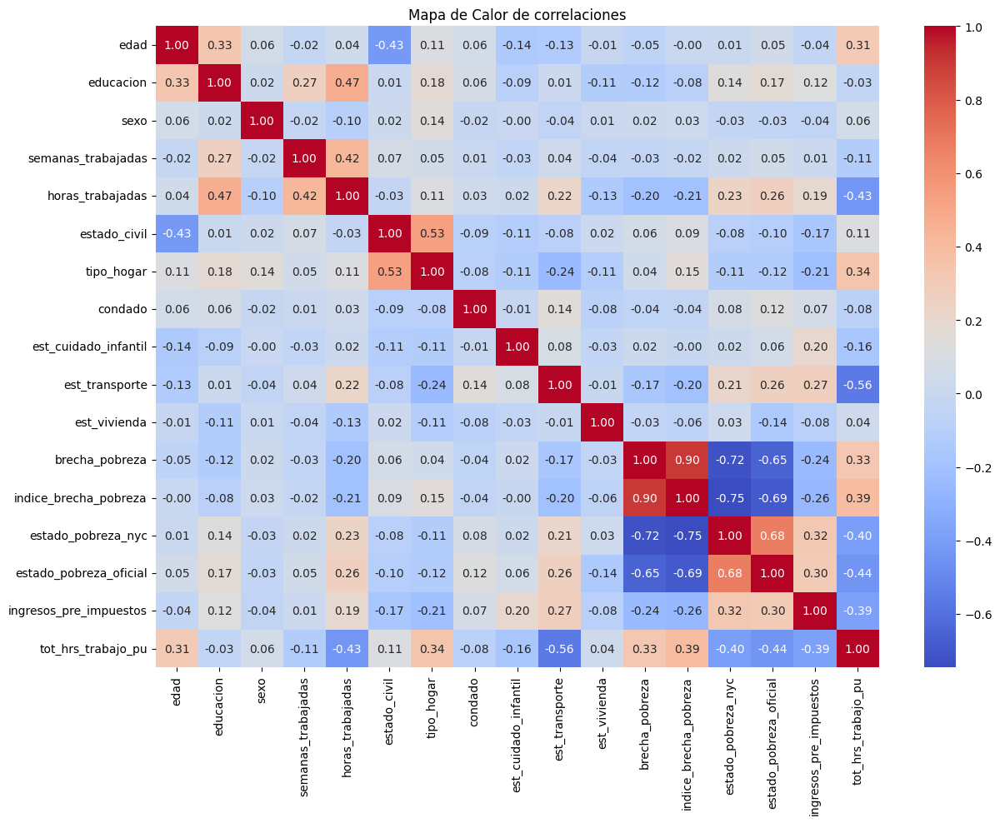

In [0]:
#Para encontrar los parametros con los que se va a predecir el estado_civil buscamos columnas correlacionadas
plt.figure(figsize=(14, 10))
sns.heatmap(clean_spark_poverty.toPandas().corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Mapa de Calor de correlaciones")
plt.show()

**Conclusion**: Se determino que las columnas mas correlacionadas son *tipo_hogar* con un 0.52 (Relacion proporcional), y *edad* con un -0.43 (Relacion inversamente proporcional)

In [0]:
print(f"Registros antes de la prediccion: {clean_spark_poverty.count()}")

Registros antes de la prediccion: 66166


In [0]:
#Aplicar modelo de kmean's para predecir columna de estado_civil
from sklearn.cluster import KMeans

df = clean_spark_poverty.toPandas()

# Aplicar el modelo (fit)
X = df[['tipo_hogar']]
kmeans = KMeans(n_clusters=6, random_state=42)
kmeans.fit(X)
df['cluster'] = kmeans.labels_

# Llenar los valores nulos
for cluster in df['cluster'].unique():
    cluster_df = df[df['cluster'] == cluster]
    estado_civil_mode = cluster_df['estado_civil'].mode()[0]
    df.loc[df['cluster'] == cluster, 'estado_civil'] = df.loc[df['cluster'] == cluster, 'educacion'].fillna(estado_civil_mode)

poverty_nonull = spark.createDataFrame(df)
poverty_nonull = poverty_nonull.drop("cluster")
print(f"Registros antes de la prediccion: {poverty_nonull.count()}")
display(poverty_nonull.select([
    sum(col(c).isNull().cast("int")).alias(c)
    for c in poverty_nonull.columns
]))

Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_callback at 0x7f5387da6a70>
Traceback (most recent call last):
  File "/databricks/python/lib/python3.10/site-packages/threadpoolctl.py", line 400, in match_module_callback
    self._make_module_from_path(filepath)
  File "/databricks/python/lib/python3.10/site-packages/threadpoolctl.py", line 515, in _make_module_from_path
    module = module_class(filepath, prefix, user_api, internal_api)
  File "/databricks/python/lib/python3.10/site-packages/threadpoolctl.py", line 606, in __init__
    self.version = self.get_version()
  File "/databricks/python/lib/python3.10/site-packages/threadpoolctl.py", line 646, in get_version
    config = get_config().split()
AttributeError: 'NoneType' object has no attribute 'split'
Exception ignored on calling ctypes callback function: <function _ThreadpoolInfo._find_modules_with_dl_iterate_phdr.<locals>.match_module_ca

Registros antes de la prediccion: 66166


edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

# Calcular métricas 
silhouette = silhouette_score(X, kmeans.labels_)
calinski_harabasz = calinski_harabasz_score(X, kmeans.labels_)
davies_bouldin = davies_bouldin_score(X, kmeans.labels_)

print("Silhouette Score:", silhouette)
print("Calinski-Harabasz Index:", calinski_harabasz)
print("Davies-Bouldin Index:", davies_bouldin)

Silhouette Score: 0.9548501550492273
Calinski-Harabasz Index: 1945044.7389200698
Davies-Bouldin Index: 0.2575051319303065


- Silhouette Score: Moderadamente excelente, lo que indica que los clusters formados tienen una cohesión razonable
- Calinski-Harabasz Index: Valor bastante alto, lo que sugiere que los clusters están bien separados entre sí
- Davies-Bouldin Index: La similitud entre los clusters es relativamente baja

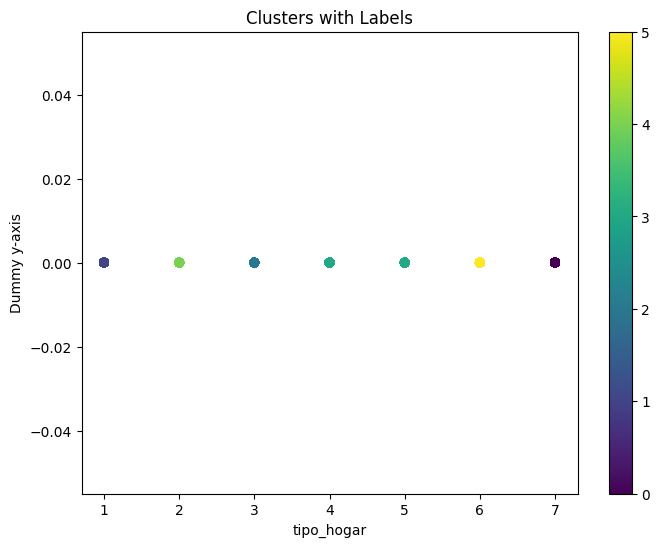

In [0]:
# Extraer las features del dataframe predictivo
X = poverty_nonull.toPandas()[['tipo_hogar']]
labels = kmeans.labels_

# Crear grafica de dispersion
plt.figure(figsize=(8, 6))
plt.scatter(X['tipo_hogar'], [0] * len(X), c=labels, cmap='viridis')
plt.xlabel('tipo_hogar')
plt.ylabel('Dummy y-axis')
plt.title('Clusters with Labels')
plt.colorbar()
plt.show()

## Estadisticos del dataset final

In [0]:
#Verifcar trasnformaciones con el metodo describe()
display(poverty_nonull.describe())

summary,edad,educacion,sexo,semanas_trabajadas,horas_trabajadas,estado_civil,tipo_hogar,condado,est_cuidado_infantil,est_transporte,est_vivienda,brecha_pobreza,indice_brecha_pobreza,estado_pobreza_nyc,estado_pobreza_oficial,ingresos_pre_impuestos,tot_hrs_trabajo_pu
count,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166,66166
mean,40.87774687906175,16.14156817700934,1.5331136837650756,0.965193603965783,21.391923344315813,16.14156817700934,2.3673336759060546,2.791146510292295,1041.0042468647966,2283.5762557632793,2834.2274832517187,1761.9731692674877,0.06373252148641233,1.8238370159900856,1.8601698757670102,111759.95199666507,2.488090560106399
stddev,21.828179119666963,6.032182677346752,0.49890604907914665,1.4030164784208237,21.1846008741458,6.032182677346752,1.8276984018165496,1.1955916256752162,4811.831543731292,2675.6736915000947,5564.060840909272,5267.625087228967,0.18469735126237216,0.3809616523013185,0.34681331928598536,135014.3252678254,1.4452088641768006
min,3,1.0,1,0.0,0,1.0,1,1,0.0,0.0,0.0,0.0,0.0,1,1,-6787.75,1
max,95,24.0,2,6.0,99,24.0,7,5,50803.949,37763.5,36710.223,54978.477,1.0,2,2,1782037.6,5
